# PTV Data Elementary Data Analysis


## Loading data

In [35]:
import geopandas as gpd
import folium

gdf_bus = gpd.read_file("../data/landing/Order_G6Z8LX (1)/ll_gda94/esrishape/whole_of_dataset/victoria/PTV/PTV_METRO_BUS_STOP.shp")
gdf_train = gpd.read_file("../data/landing/Order_G6Z8LX (1)/ll_gda94/esrishape/whole_of_dataset/victoria/PTV/PTV_METRO_TRAIN_STATION.shp")
gdf_tram = gpd.read_file("../data/landing/Order_G6Z8LX (1)/ll_gda94/esrishape/whole_of_dataset/victoria/PTV/PTV_METRO_TRAM_STOP.shp")


## Shape Analysis

In [36]:
len(gdf_bus)

18559

In [37]:
gdf_bus = gdf_bus.dropna()
len(gdf_bus)

18428

In [38]:
len(gdf_tram)

1665

In [39]:
gdf_tram = gdf_tram.dropna()
len(gdf_tram)

1665

In [40]:
len(gdf_train)

220

In [41]:
gdf_train = gdf_train.dropna()
len(gdf_train)

220

In [42]:
import pandas as pd
import re

# Sample dataframe (assuming you've loaded it into a pandas DataFrame)
# Modify as necessary to work with your actual GeoDataFrame if it's in geopandas
# df = pd.DataFrame({'STOP_ID': ..., 'LATITUDE': ..., 'STOP_NAME': ...})

# Function to extract suburb from STOP_NAME
def extract_suburb(stop_name):
    # Use regex to find the text within parentheses (suburb name)
    match = re.search(r'\((.*?)\)', stop_name)
    if match:
        return match.group(1)  # Return the suburb inside parentheses
    else:
        return None  # Return None if no match is found

In [43]:
gdf_bus['SUBURB_NAME'] = gdf_bus['STOP_NAME'].apply(extract_suburb)
gdf_tram['SUBURB_NAME'] = gdf_tram['STOP_NAME'].apply(extract_suburb)
gdf_train['SUBURB_NAME'] = gdf_train['STOP_NAME'].apply(extract_suburb)


## Visualisations of densities of metro bus stops, tram stops & train stations 

In [44]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster

# Convert the GeoDataFrame to EPSG:4326 (WGS84) for folium compatibility
gdf = gdf_bus.to_crs(epsg=4283)

# Create a folium map centered on the mean latitude and longitude
mean_lat = gdf.geometry.y.mean()
mean_lon = gdf.geometry.x.mean()
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=12, tiles="CartoDB positron")

# Use a MarkerCluster to group bus stop locations
marker_cluster = MarkerCluster().add_to(m)

# Add markers for each bus stop in the GeoDataFrame
for _, row in gdf.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=f"Bus Stop: {row['STOP_NAME']} (Stop ID: {row['STOP_ID']})"
    ).add_to(marker_cluster)

# Save the map to an HTML file (optional)
m.save("metro_bus_stops_map.html")

# Display the map
m


In [45]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster

# Convert the GeoDataFrame to EPSG:4326 (WGS84) for folium compatibility
gdf = gdf_train.to_crs(epsg=4283)

# Create a folium map centered on the mean latitude and longitude
mean_lat = gdf.geometry.y.mean()
mean_lon = gdf.geometry.x.mean()
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=12, tiles="CartoDB positron")

# Use a MarkerCluster to group bus stop locations
marker_cluster = MarkerCluster().add_to(m)

# Add markers for each bus stop in the GeoDataFrame
for _, row in gdf.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=f"Train Station: {row['STOP_NAME']} (Stop ID: {row['STOP_ID']})"
    ).add_to(marker_cluster)

# Save the map to an HTML file (optional)
m.save("metro_train_stations_map.html")

# Display the map
m


## Checking for Suburbs with Highest PTV Connectivity

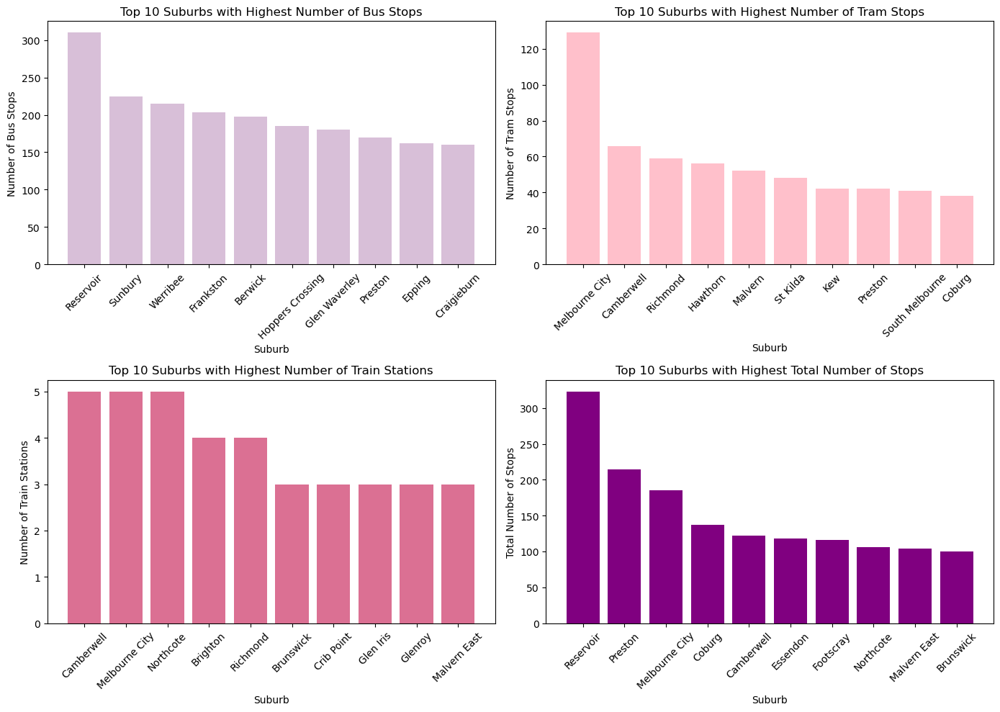

In [46]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming df_bus, df_tram, df_train are your respective DataFrames for buses, trams, and trains
# And 'SUBURB_NAME' has already been extracted from 'STOP_NAME'

# 1. Group by suburb and count stops for each transport mode
bus_stops_per_suburb = gdf_bus.groupby('SUBURB_NAME')['STOP_ID'].count().reset_index()
bus_stops_per_suburb.columns = ['SUBURB_NAME', 'bus_stop_count']

tram_stops_per_suburb = gdf_tram.groupby('SUBURB_NAME')['STOP_ID'].count().reset_index()
tram_stops_per_suburb.columns = ['SUBURB_NAME', 'tram_stop_count']

train_stations_per_suburb = gdf_train.groupby('SUBURB_NAME')['STOP_ID'].count().reset_index()
train_stations_per_suburb.columns = ['SUBURB_NAME', 'train_station_count']

# 2. Merge all the data to get total stops per suburb
connectivity_df = bus_stops_per_suburb.merge(tram_stops_per_suburb, on='SUBURB_NAME', how='outer')
connectivity_df = connectivity_df.merge(train_stations_per_suburb, on='SUBURB_NAME', how='outer')

# Add a column for the total number of stops (bus + tram + train)
connectivity_df['total_stop_count'] = (connectivity_df['bus_stop_count'] +
                                       connectivity_df['tram_stop_count'] +
                                       connectivity_df['train_station_count'])

# Sort by stop count for each mode to get the top 10 suburbs
top_10_bus_suburbs = connectivity_df.nlargest(10, 'bus_stop_count')
top_10_tram_suburbs = connectivity_df.nlargest(10, 'tram_stop_count')
top_10_train_suburbs = connectivity_df.nlargest(10, 'train_station_count')
top_10_total_suburbs = connectivity_df.nlargest(10, 'total_stop_count')

# 3. Create a 2x2 grid of plots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))  # 2 rows, 2 columns

# Plot top 10 bus stops
axes[0, 0].bar(top_10_bus_suburbs['SUBURB_NAME'], top_10_bus_suburbs['bus_stop_count'], color='thistle')
axes[0, 0].set_title('Top 10 Suburbs with Highest Number of Bus Stops')
axes[0, 0].set_xlabel('Suburb')
axes[0, 0].set_ylabel('Number of Bus Stops')
axes[0, 0].tick_params(axis='x', rotation=45)

# Plot top 10 tram stops
axes[0, 1].bar(top_10_tram_suburbs['SUBURB_NAME'], top_10_tram_suburbs['tram_stop_count'], color='pink')
axes[0, 1].set_title('Top 10 Suburbs with Highest Number of Tram Stops')
axes[0, 1].set_xlabel('Suburb')
axes[0, 1].set_ylabel('Number of Tram Stops')
axes[0, 1].tick_params(axis='x', rotation=45)

# Plot top 10 train stations
axes[1, 0].bar(top_10_train_suburbs['SUBURB_NAME'], top_10_train_suburbs['train_station_count'], color='palevioletred')
axes[1, 0].set_title('Top 10 Suburbs with Highest Number of Train Stations')
axes[1, 0].set_xlabel('Suburb')
axes[1, 0].set_ylabel('Number of Train Stations')
axes[1, 0].tick_params(axis='x', rotation=45)

# Plot top 10 total stops (bus + tram + train)
axes[1, 1].bar(top_10_total_suburbs['SUBURB_NAME'], top_10_total_suburbs['total_stop_count'], color='purple')
axes[1, 1].set_title('Top 10 Suburbs with Highest Total Number of Stops')
axes[1, 1].set_xlabel('Suburb')
axes[1, 1].set_ylabel('Total Number of Stops')
axes[1, 1].tick_params(axis='x', rotation=45)

# Adjust layout for better spacing between plots
plt.tight_layout()

# Show the plot
plt.show()
